## read image

In [138]:
import os
from skimage import io
import matplotlib.pyplot as plt
import cv2
from PIL import Image

image.shape:(480, 721, 4)


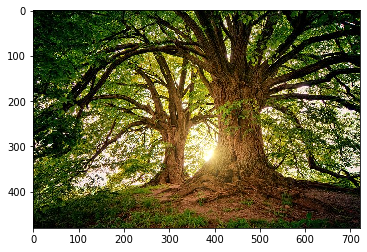

In [139]:
image_path = '../pics/1.jpg'
image=io.imread(image_path)
print("image.shape:{}".format(image.shape))
plt.imshow(image)

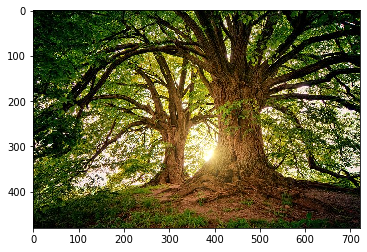

In [140]:
plt.imshow(cv2.imread(image_path)[...,::-1])

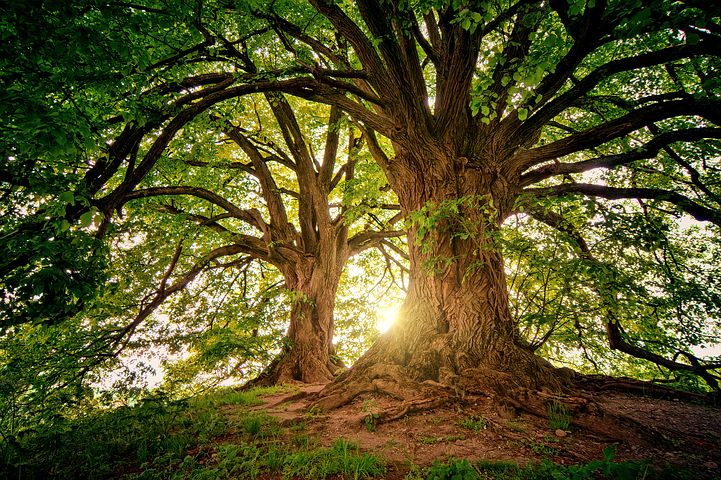

In [141]:
Image.open(image_path).convert('RGB')

## ToPILImage

Convert a tensor or an ndarray to PIL Image.

    Converts a torch.*Tensor of shape C x H x W or a numpy ndarray of shape
    H x W x C to a PIL Image while preserving the value range.

    Args:
        mode (`PIL.Image mode`_): color space and pixel depth of input data (optional).
            If ``mode`` is ``None`` (default) there are some assumptions made about the input data:
             - If the input has 4 channels, the ``mode`` is assumed to be ``RGBA``.
             - If the input has 3 channels, the ``mode`` is assumed to be ``RGB``.
             - If the input has 2 channels, the ``mode`` is assumed to be ``LA``.
             - If the input has 1 channel, the ``mode`` is determined by the data type (i.e ``int``, ``float``,
               ``short``).

In [142]:
from torchvision.transforms import transforms

type(img):<class 'PIL.Image.Image'>


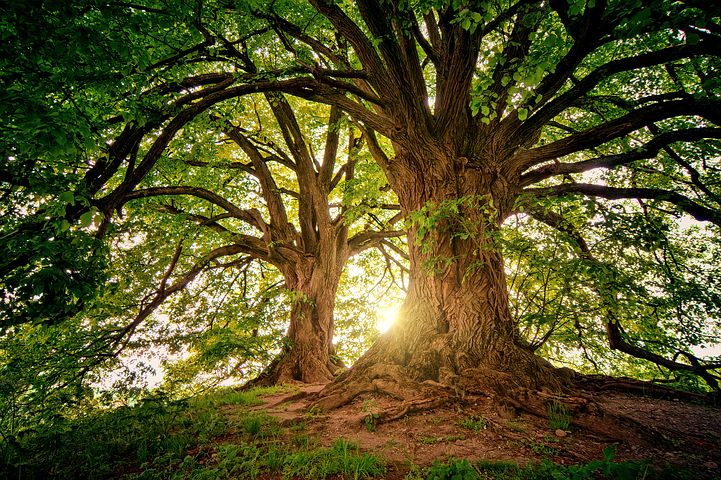

In [145]:
img=transforms.ToPILImage('RGB')(image[...,:3])
print("type(img):{}".format(type(img)))
img

## RandomResizedCrop


Crop the given PIL Image to random size and aspect ratio.

    A crop of random size (default: of 0.08 to 1.0) of the original size and a random
    aspect ratio (default: of 3/4 to 4/3) of the original aspect ratio is made. This crop
    is finally resized to given size.
    This is popularly used to train the Inception networks.

    Args:
        size: expected output size of each edge
        scale: range of size of the origin size cropped
        ratio: range of aspect ratio of the origin aspect ratio cropped
        interpolation: Default: PIL.Image.BILINEAR

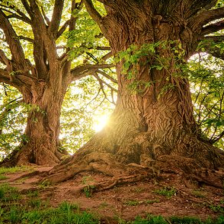

In [220]:
transforms.RandomResizedCrop(224,scale=(0.08,1))(img)

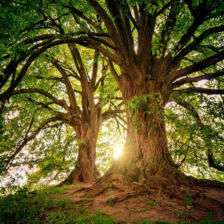

In [230]:
transforms.RandomResizedCrop(224,scale=(0.5,1))(img)

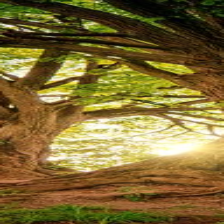

In [242]:
transforms.RandomResizedCrop(224,scale=(0.08,1),ratio=(0.1,0.2))(img)

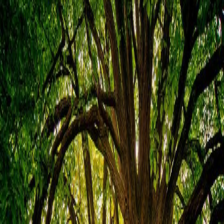

In [243]:
transforms.RandomResizedCrop(224,scale=(0.08,1),ratio=(5,8))(img)

In [216]:
import random
target_area = random.uniform(*(0.08,1)) * 8
target_area

5.90268743623972

## Resize


Resize the input PIL Image to the given size.

    Args:
        size (sequence or int): Desired output size. If size is a sequence like
            (h, w), output size will be matched to this. If size is an int,
            smaller edge of the image will be matched to this number.
            i.e, if height > width, then image will be rescaled to
            (size * height / width, size)
        interpolation (int, optional): Desired interpolation. Default is
            ``PIL.Image.BILINEAR``

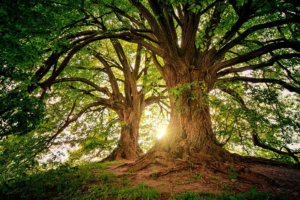

In [378]:
transforms.Resize(200)(img)

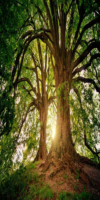

In [379]:
transforms.Resize((200,100))(img)

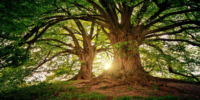

In [380]:
transforms.Resize((100,200))(img)

## Pad

Pad the given PIL Image on all sides with the given "pad" value.

    Args:
        padding (int or tuple): Padding on each border. If a single int is provided this
            is used to pad all borders. If tuple of length 2 is provided this is the padding
            on left/right and top/bottom respectively. If a tuple of length 4 is provided
            this is the padding for the left, top, right and bottom borders
            respectively.
        fill (int or tuple): Pixel fill value for constant fill. Default is 0. If a tuple of
            length 3, it is used to fill R, G, B channels respectively.
            This value is only used when the padding_mode is constant
        padding_mode (str): Type of padding. Should be: constant, edge, reflect or symmetric.
            Default is constant.

            - constant: pads with a constant value, this value is specified with fill

            - edge: pads with the last value at the edge of the image

            - reflect: pads with reflection of image without repeating the last value on the edge

                For example, padding [1, 2, 3, 4] with 2 elements on both sides in reflect mode
                will result in [3, 2, 1, 2, 3, 4, 3, 2]

            - symmetric: pads with reflection of image repeating the last value on the edge

                For example, padding [1, 2, 3, 4] with 2 elements on both sides in symmetric mode
                will result in [2, 1, 1, 2, 3, 4, 4, 3]

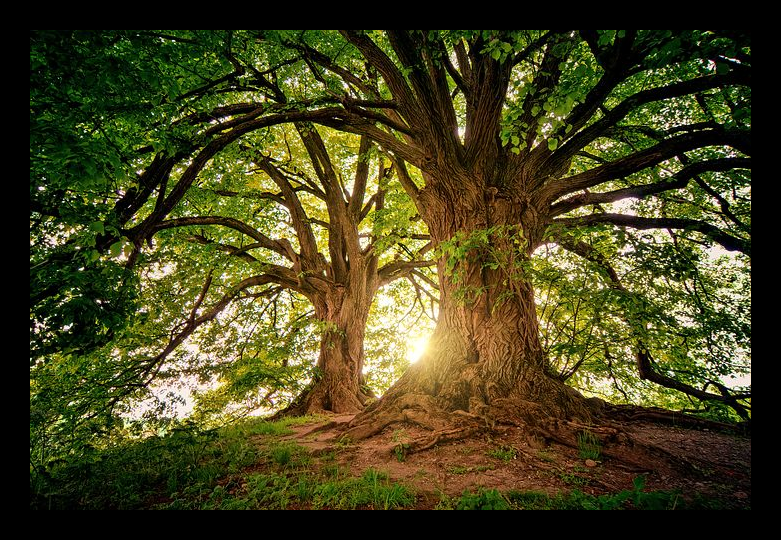

In [382]:
transforms.Pad(30)(img)

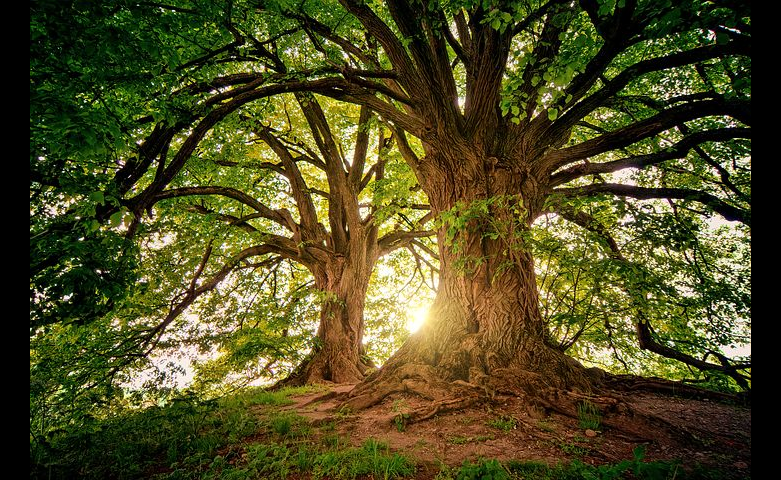

In [383]:
transforms.Pad((30,0))(img)

## RandomCrop


Crop the given PIL Image at a random location.

    Args:
        size (sequence or int): Desired output size of the crop. If size is an
            int instead of sequence like (h, w), a square crop (size, size) is
            made.
        padding (int or sequence, optional): Optional padding on each border
            of the image. Default is None, i.e no padding. If a sequence of length
            4 is provided, it is used to pad left, top, right, bottom borders
            respectively. If a sequence of length 2 is provided, it is used to
            pad left/right, top/bottom borders, respectively.
        pad_if_needed (boolean): It will pad the image if smaller than the
            desired size to avoid raising an exception. Since cropping is done
            after padding, the padding seems to be done at a random offset.
        fill: Pixel fill value for constant fill. Default is 0. If a tuple of
            length 3, it is used to fill R, G, B channels respectively.
            This value is only used when the padding_mode is constant
        padding_mode: Type of padding. Should be: constant, edge, reflect or symmetric. Default is constant.

             - constant: pads with a constant value, this value is specified with fill

             - edge: pads with the last value on the edge of the image

             - reflect: pads with reflection of image (without repeating the last value on the edge)

                padding [1, 2, 3, 4] with 2 elements on both sides in reflect mode
                will result in [3, 2, 1, 2, 3, 4, 3, 2]

             - symmetric: pads with reflection of image (repeating the last value on the edge)

                padding [1, 2, 3, 4] with 2 elements on both sides in symmetric mode
                will result in [2, 1, 1, 2, 3, 4, 4, 3]

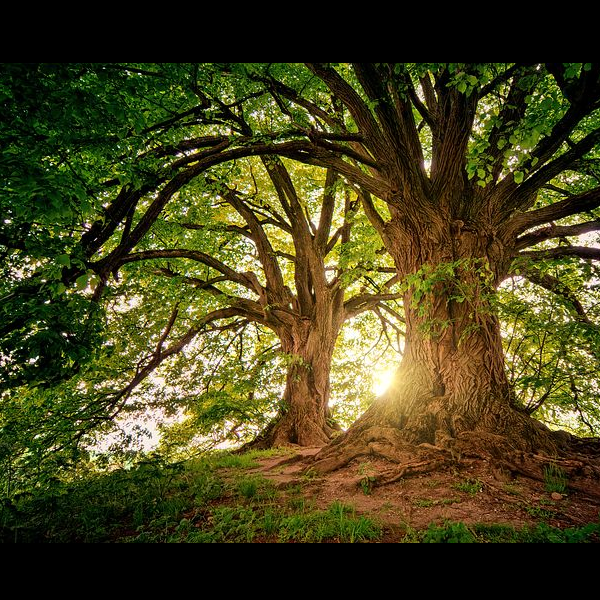

In [403]:
transforms.RandomCrop(600,pad_if_needed=True)(img)

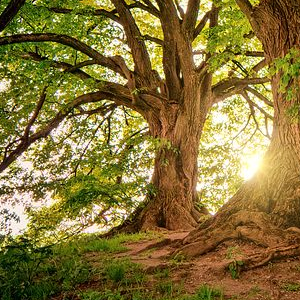

In [405]:
transforms.RandomCrop(300,pad_if_needed=True)(img)

## RandomPerspective


Performs Perspective transformation of the given PIL Image randomly with a given probability.

    Args:
        interpolation : Default- Image.BICUBIC

        p (float): probability of the image being perspectively transformed. Default value is 0.5

        distortion_scale(float): it controls the degree of distortion and ranges from 0 to 1. Default value is 0.5.


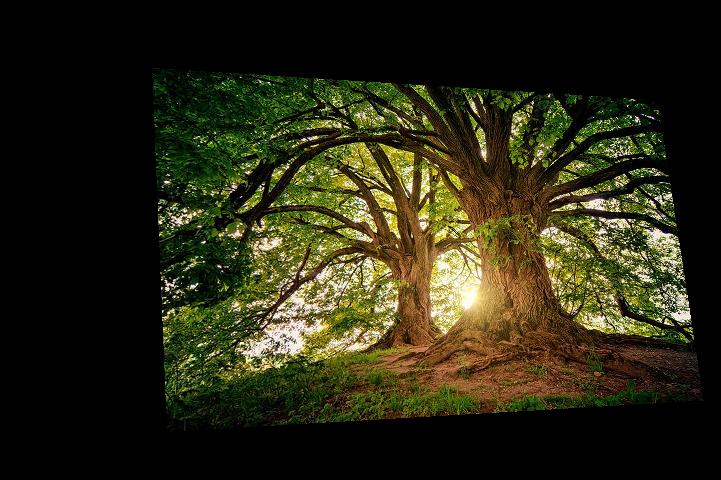

In [409]:
transforms.RandomPerspective()(img)

## FiveCrop


Crop the given PIL Image into four corners and the central crop

    .. Note::
         This transform returns a tuple of images and there may be a mismatch in the number of
         inputs and targets your Dataset returns. See below for an example of how to deal with
         this.

    Args:
         size (sequence or int): Desired output size of the crop. If size is an ``int``
            instead of sequence like (h, w), a square crop of size (size, size) is made.

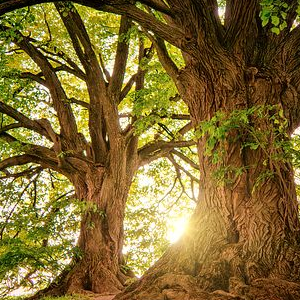

In [417]:
transforms.FiveCrop(300)(img)[4]

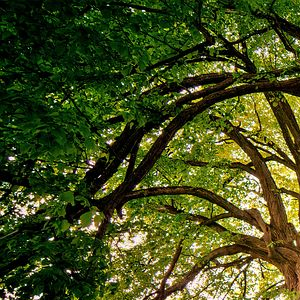

In [418]:
transforms.FiveCrop(300)(img)[0]

## RandomRotation

Rotate the image by angle.

    Args:
        degrees (sequence or float or int): Range of degrees to select from.
            If degrees is a number instead of sequence like (min, max), the range of degrees
            will be (-degrees, +degrees).
        resample ({PIL.Image.NEAREST, PIL.Image.BILINEAR, PIL.Image.BICUBIC}, optional):
            An optional resampling filter. See `filters`_ for more information.
            If omitted, or if the image has mode "1" or "P", it is set to PIL.Image.NEAREST.
        expand (bool, optional): Optional expansion flag.
            If true, expands the output to make it large enough to hold the entire rotated image.
            If false or omitted, make the output image the same size as the input image.
            Note that the expand flag assumes rotation around the center and no translation.
        center (2-tuple, optional): Optional center of rotation.
            Origin is the upper left corner.
            Default is the center of the image.

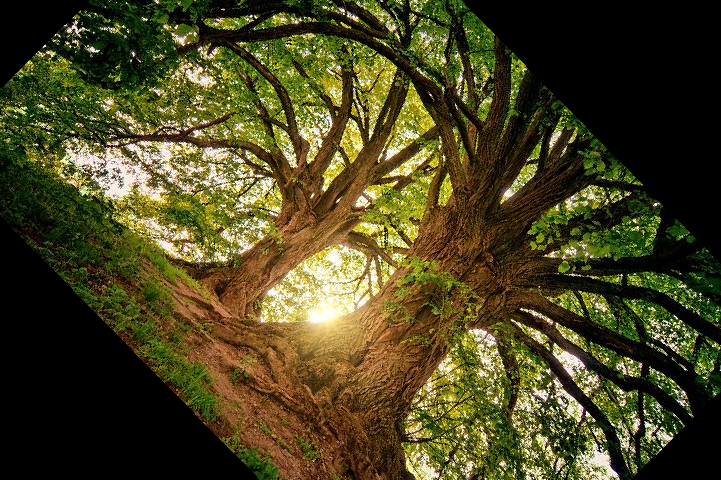

In [431]:
transforms.RandomRotation(degrees=90)(img)

## CenterCrop

Crops the given PIL Image at the center.

    Args:
        size (sequence or int): Desired output size of the crop. If size is an
            int instead of sequence like (h, w), a square crop (size, size) is
            made.


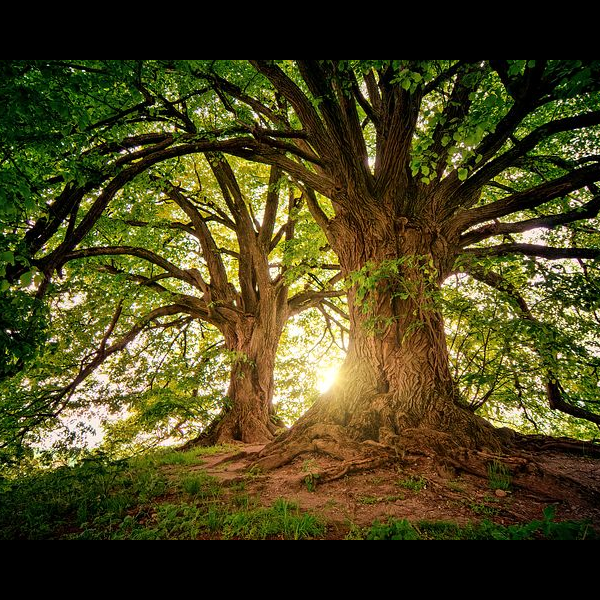

In [436]:
transforms.CenterCrop(600)(img)

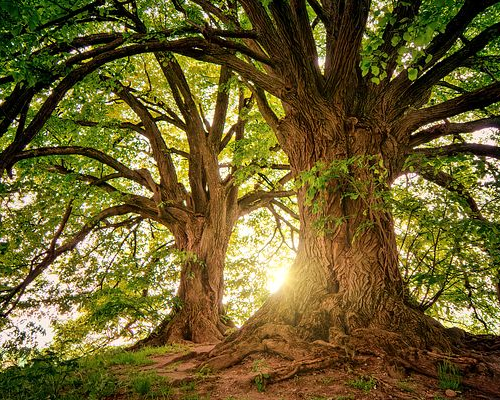

In [438]:
transforms.CenterCrop(size=(400,500))(img)

## RandomAffine

Random affine transformation of the image keeping center invariant

    Args:
        degrees (sequence or float or int): Range of degrees to select from.
            If degrees is a number instead of sequence like (min, max), the range of degrees
            will be (-degrees, +degrees). Set to 0 to deactivate rotations.
        translate (tuple, optional): tuple of maximum absolute fraction for horizontal
            and vertical translations. For example translate=(a, b), then horizontal shift
            is randomly sampled in the range -img_width * a < dx < img_width * a and vertical shift is
            randomly sampled in the range -img_height * b < dy < img_height * b. Will not translate by default.
        scale (tuple, optional): scaling factor interval, e.g (a, b), then scale is
            randomly sampled from the range a <= scale <= b. Will keep original scale by default.
        shear (sequence or float or int, optional): Range of degrees to select from.
            If degrees is a number instead of sequence like (min, max), the range of degrees
            will be (-degrees, +degrees). Will not apply shear by default
        resample ({PIL.Image.NEAREST, PIL.Image.BILINEAR, PIL.Image.BICUBIC}, optional):
            An optional resampling filter. See `filters`_ for more information.
            If omitted, or if the image has mode "1" or "P", it is set to PIL.Image.NEAREST.
        fillcolor (int): Optional fill color for the area outside the transform in the output image. (Pillow>=5.0.0)


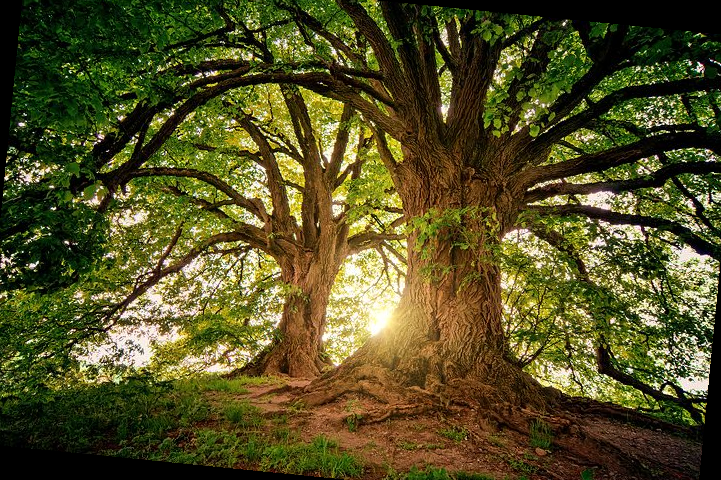

In [440]:
transforms.RandomAffine(degrees=10)(img)

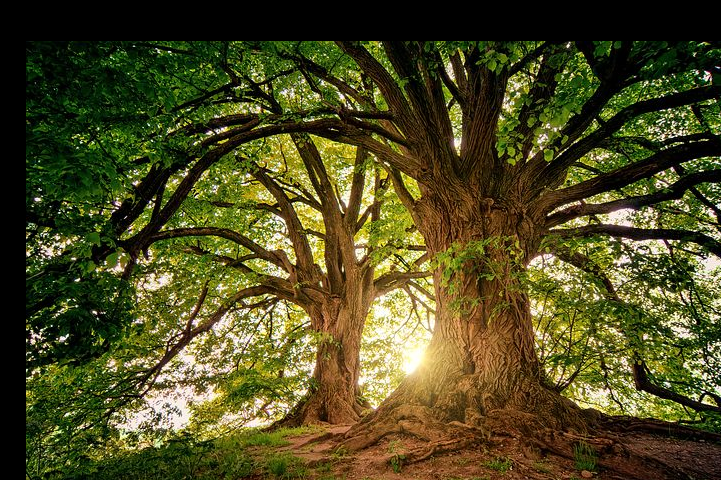

In [447]:
transforms.RandomAffine(degrees=0,translate=(0.5,0.4))(img)

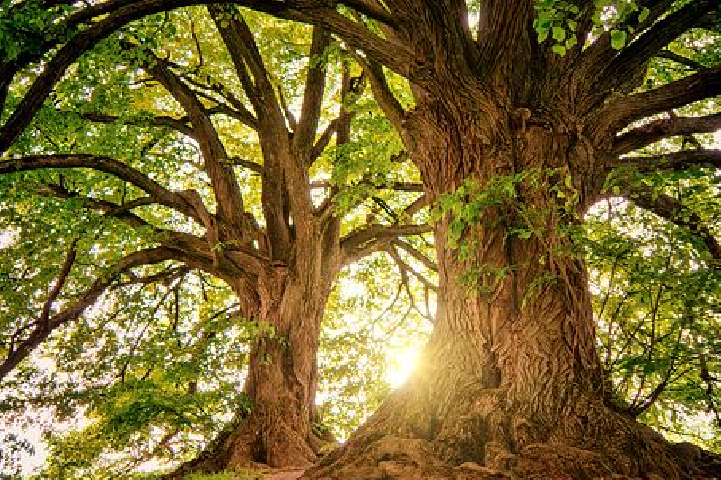

In [462]:
transforms.RandomAffine(degrees=0,scale=(0.1,1.8))(img)

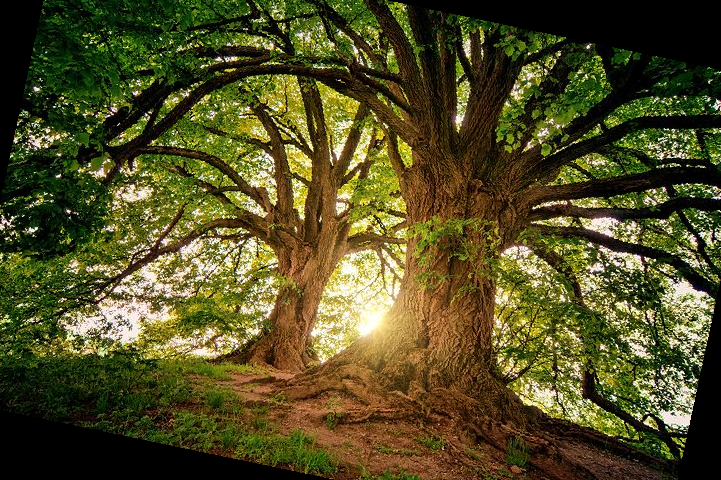

In [471]:
# 不清楚shear的含义
transforms.RandomAffine(degrees=(10,20),shear=(0.4,0.5))(img)

## Grayscale

Convert image to grayscale.

    Args:
        num_output_channels (int): (1 or 3) number of channels desired for output image

    Returns:
        PIL Image: Grayscale version of the input.
        - If num_output_channels == 1 : returned image is single channel
        - If num_output_channels == 3 : returned image is 3 channel with r == g == b

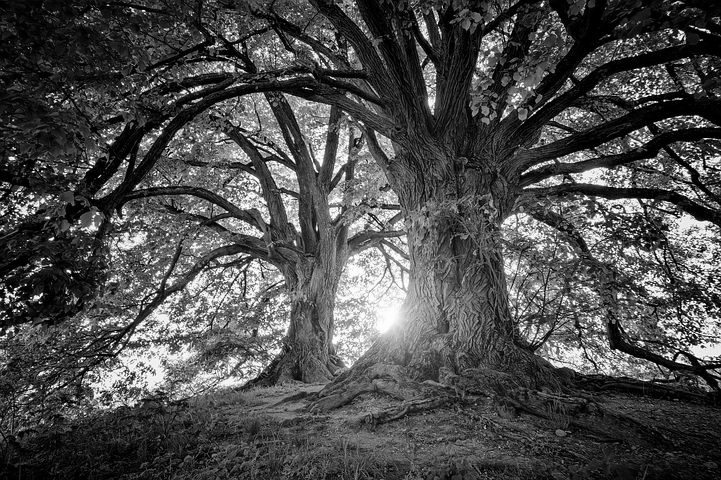

In [474]:
transforms.Grayscale(num_output_channels=3)(img)

## RandomGrayscale


Randomly convert image to grayscale with a probability of p (default 0.1).

    Args:
        p (float): probability that image should be converted to grayscale.

    Returns:
        PIL Image: Grayscale version of the input image with probability p and unchanged
        with probability (1-p).
        - If input image is 1 channel: grayscale version is 1 channel
        - If input image is 3 channel: grayscale version is 3 channel with r == g == b

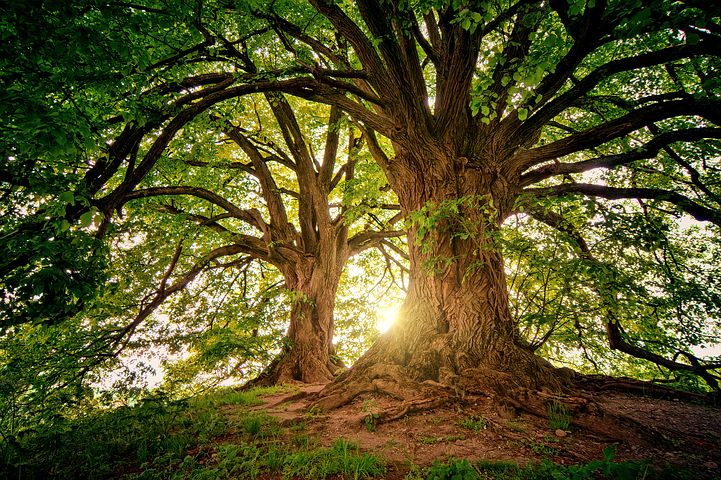

In [490]:
transforms.RandomGrayscale(p=0.5)(img)

## ColorJitter

Randomly change the brightness, contrast and saturation of an image.

    Args:
        brightness (float or tuple of float (min, max)): How much to jitter brightness.
            brightness_factor is chosen uniformly from [max(0, 1 - brightness), 1 + brightness]
            or the given [min, max]. Should be non negative numbers.
        contrast (float or tuple of float (min, max)): How much to jitter contrast.
            contrast_factor is chosen uniformly from [max(0, 1 - contrast), 1 + contrast]
            or the given [min, max]. Should be non negative numbers.
        saturation (float or tuple of float (min, max)): How much to jitter saturation.
            saturation_factor is chosen uniformly from [max(0, 1 - saturation), 1 + saturation]
            or the given [min, max]. Should be non negative numbers.
        hue (float or tuple of float (min, max)): How much to jitter hue.
            hue_factor is chosen uniformly from [-hue, hue] or the given [min, max].
            Should have 0<= hue <= 0.5 or -0.5 <= min <= max <= 0.5.
            
（1）图象对比度：一副图像中，各种不同颜色最亮处和最暗处之间的差别，差别越大对比度越高，这个跟分辨率没有多少关系，只跟最暗和最亮有关系，对比度越高一个图像给人的感觉就越刺眼，更加鲜亮，突出；越低则给人感觉变化不明显，反差就越小。这个概念只是在给定的图像中，与图像中颜色亮度的变化有关。

（2）图象亮度：一副图像给人的一种直观感受，如果是灰度图像，则跟灰度值有关，灰度值越高则图像越亮。

（3）图象饱和度：彩色图像的概念，饱和度为0的话，图像表现为灰度图像；饱和度越高颜色表现出种类越多，颜色表现更丰富，反之亦然。

In [303]:
print("origin val:{} \nbrightness=(1.1,1.1):{} \ncontrast=(0.1,0.1):{}\ncontrast=(2.1,2.1):{}\nsaturation=(0.1,0.1):{}\nsaturation=(2.1,2.1):{}".
      format(np.array(img).mean(axis=(0,1)),
np.array(transforms.ColorJitter(brightness=(1.1,1.1))(img)).mean(axis=(0,1)),
np.array(transforms.ColorJitter(contrast=(0.1,0.1))(img)).mean(axis=(0,1)),
np.array(transforms.ColorJitter(contrast=(2.1,2.1))(img)).mean(axis=(0,1)),
np.array(transforms.ColorJitter(saturation=(0.1,0.1))(img)).mean(axis=(0,1)),
np.array(transforms.ColorJitter(saturation=(2.1,2.1))(img)).mean(axis=(0,1)),               
))

origin val:[84.10572989 80.73462783 36.95407709] 
brightness=(1.1,1.1):[91.20549584 87.77013985 40.26551953] 
contrast=(0.1,0.1):[76.34921983 76.01600786 71.65152855]
contrast=(2.1,2.1):[94.69672908 86.99435969 32.76595585]
saturation=(0.1,0.1):[76.59159443 76.25831022 71.87192268]
saturation=(2.1,2.1):[92.89160599 85.21616967 15.93182212]


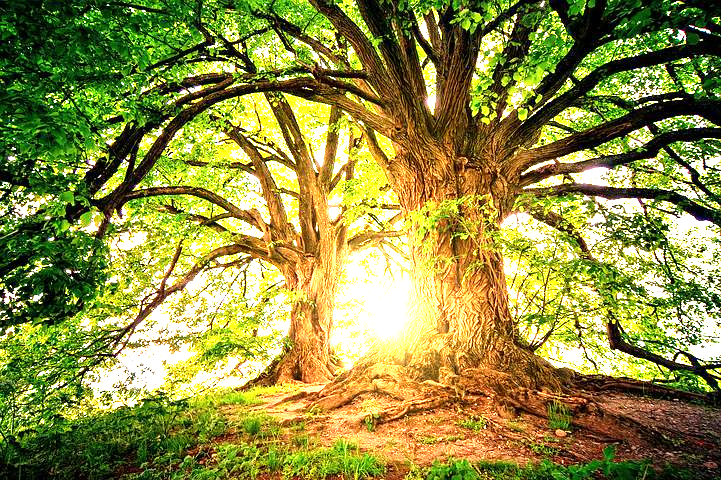

In [322]:
transforms.ColorJitter(brightness=(2.1,2.1))(img)

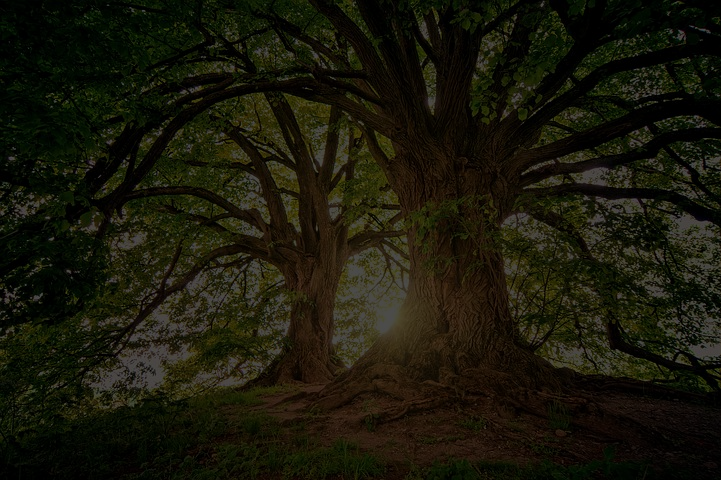

In [321]:
transforms.ColorJitter(brightness=(0.3,0.3))(img)

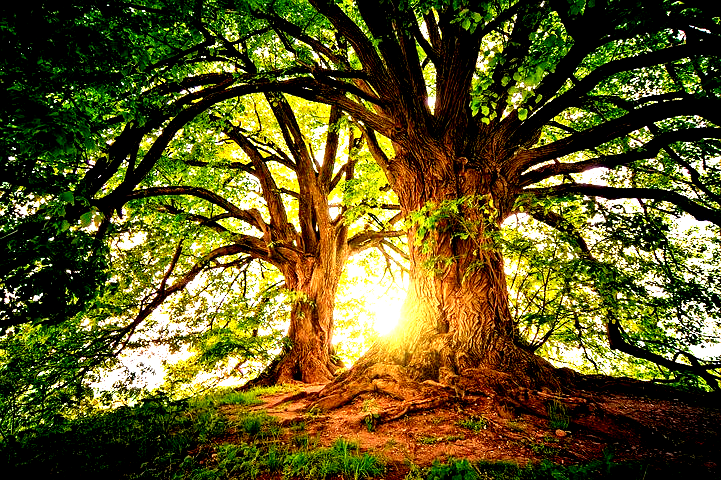

In [324]:
transforms.ColorJitter(contrast=(2.1,2.1))(img)

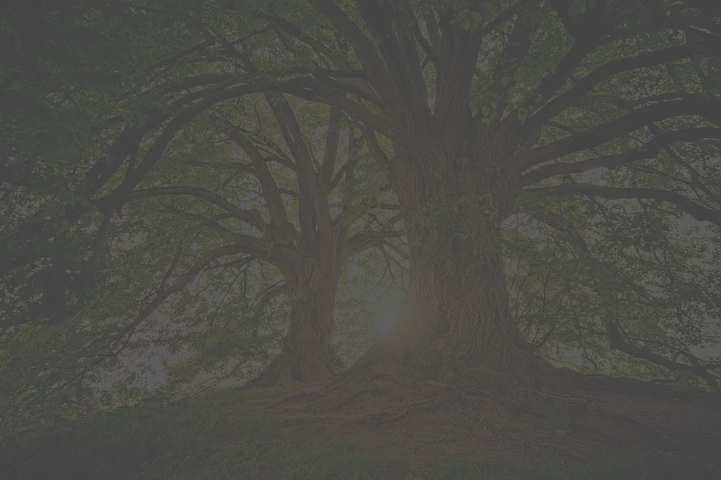

In [325]:
transforms.ColorJitter(contrast=(0.1,0.1))(img)

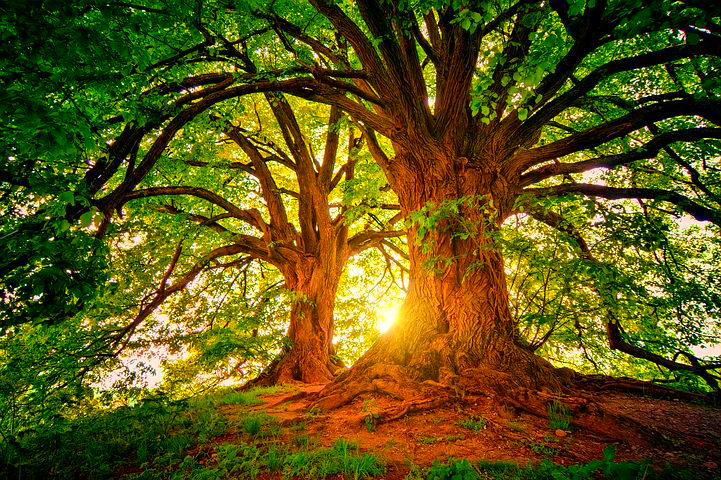

In [326]:
transforms.ColorJitter(saturation=(2.1,2.1))(img)

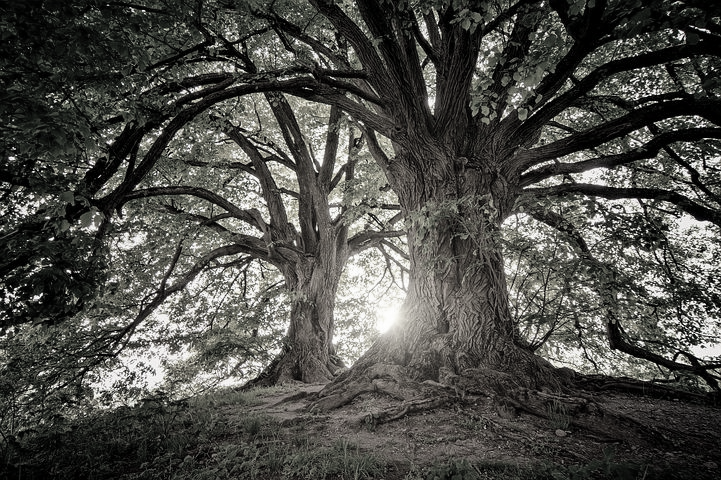

In [327]:
transforms.ColorJitter(saturation=(0.1,0.1))(img)

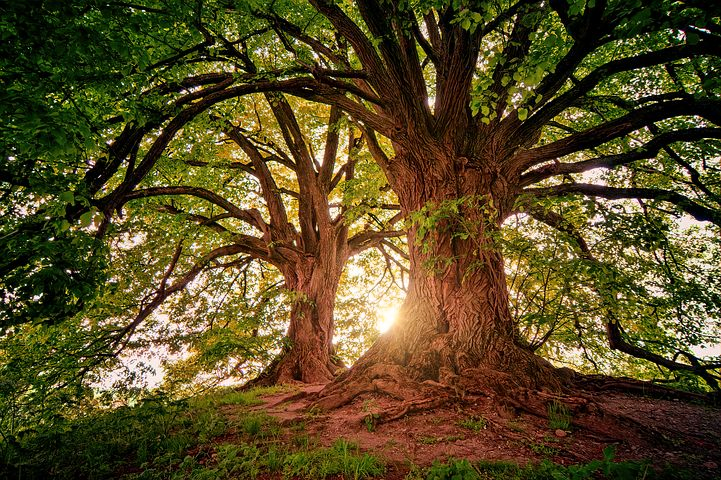

In [377]:
transforms.ColorJitter(hue=0.1)(img)

## ToTensor

Convert a ``PIL Image`` or ``numpy.ndarray`` to tensor.

    Converts a PIL Image or numpy.ndarray (H x W x C) in the range
    [0, 255] to a torch.FloatTensor of shape (C x H x W) in the range [0.0, 1.0]


In [147]:
transforms.ToTensor()(img)

tensor([[[0.0118, 0.0196, 0.0314,  ..., 0.0235, 0.0235, 0.0039],
         [0.0000, 0.0000, 0.0000,  ..., 0.0157, 0.0157, 0.0039],
         [0.0000, 0.0000, 0.0000,  ..., 0.0157, 0.0157, 0.0118],
         ...,
         [0.0039, 0.0000, 0.0000,  ..., 0.0902, 0.1490, 0.0510],
         [0.0078, 0.0000, 0.0000,  ..., 0.0000, 0.0196, 0.0431],
         [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0824]],

        [[0.0431, 0.0549, 0.0667,  ..., 0.0000, 0.0000, 0.0000],
         [0.0078, 0.0118, 0.0118,  ..., 0.0000, 0.0000, 0.0000],
         [0.0196, 0.0157, 0.0157,  ..., 0.0000, 0.0000, 0.0039],
         ...,
         [0.0314, 0.0157, 0.0078,  ..., 0.1216, 0.1804, 0.0706],
         [0.0314, 0.0196, 0.0078,  ..., 0.0235, 0.0627, 0.0706],
         [0.0078, 0.0078, 0.0078,  ..., 0.0588, 0.0275, 0.1098]],

        [[0.0510, 0.0510, 0.0627,  ..., 0.0000, 0.0000, 0.0000],
         [0.0157, 0.0078, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
         [0.0196, 0.0157, 0.0039,  ..., 0.0000, 0.0000, 0.

## Normalize


Normalize a tensor image with mean and standard deviation.
    Given mean: ``(M1,...,Mn)`` and std: ``(S1,..,Sn)`` for ``n`` channels, this transform
    will normalize each channel of the input ``torch.*Tensor`` i.e.
    ``input[channel] = (input[channel] - mean[channel]) / std[channel]``

In [148]:
nor=transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                    std=[0.229, 0.224, 0.225])
nor(transforms.ToTensor()(img))

tensor([[[-2.0665, -2.0323, -1.9809,  ..., -2.0152, -2.0152, -2.1008],
         [-2.1179, -2.1179, -2.1179,  ..., -2.0494, -2.0494, -2.1008],
         [-2.1179, -2.1179, -2.1179,  ..., -2.0494, -2.0494, -2.0665],
         ...,
         [-2.1008, -2.1179, -2.1179,  ..., -1.7240, -1.4672, -1.8953],
         [-2.0837, -2.1179, -2.1179,  ..., -2.1179, -2.0323, -1.9295],
         [-2.1179, -2.1179, -2.1179,  ..., -2.1179, -2.1179, -1.7583]],

        [[-1.8431, -1.7906, -1.7381,  ..., -2.0357, -2.0357, -2.0357],
         [-2.0007, -1.9832, -1.9832,  ..., -2.0357, -2.0357, -2.0357],
         [-1.9482, -1.9657, -1.9657,  ..., -2.0357, -2.0357, -2.0182],
         ...,
         [-1.8957, -1.9657, -2.0007,  ..., -1.4930, -1.2304, -1.7206],
         [-1.8957, -1.9482, -2.0007,  ..., -1.9307, -1.7556, -1.7206],
         [-2.0007, -2.0007, -2.0007,  ..., -1.7731, -1.9132, -1.5455]],

        [[-1.5779, -1.5779, -1.5256,  ..., -1.8044, -1.8044, -1.8044],
         [-1.7347, -1.7696, -1.8044,  ..., -1